Course overview: http://openml.github.io/course

In [26]:
options(warn=-1)
library(mlr) # ML library
library(OpenML) # Import and share data, flows, results
library(ggplot2) # Plotting
library(cowplot) # Plot styling
library(rattle) # Plotting trees
library(grid) # For linegraphs
library(reshape2) # Reformatting data

# Neural Networks
Reverse-engineering the brain

- Reverse-engineering the Brain
    - Very adept for vision, manipulation, speech understanding, language
    - Not so well suited for high-dimensional data, large complex networks
    - Very well established field, lots of media attention

## Overview of Algorithms
- Perceptrons
    - Linear classifier based on neuron
- Gradient Descent
    - Essential part of many kinds of learning algorithms
- Feedforward (multilayer) networks
    - Simplest deep learning algorithm
- Backpropagation
    - Most widely used algorithm for training neural nets

## Brain vs CPU
- Lots of research into mapping and studying the brain
- $\sim$ 10^10 neurons, switching in $\sim$ .001s (transistor $\sim$ GHz)
- $\sim$ 10^5 connections per neuron (transistor $\sim$ 10)
- Consumes $\sim$ 40W
- Recognizes scene in $\sim$ .1s (massive parallellism!)
- Visual cortex (V1) $\sim$ 140 million neurons
    - Next cortices (V2-V5) do increasingly complex processing

## Example: Character recognition

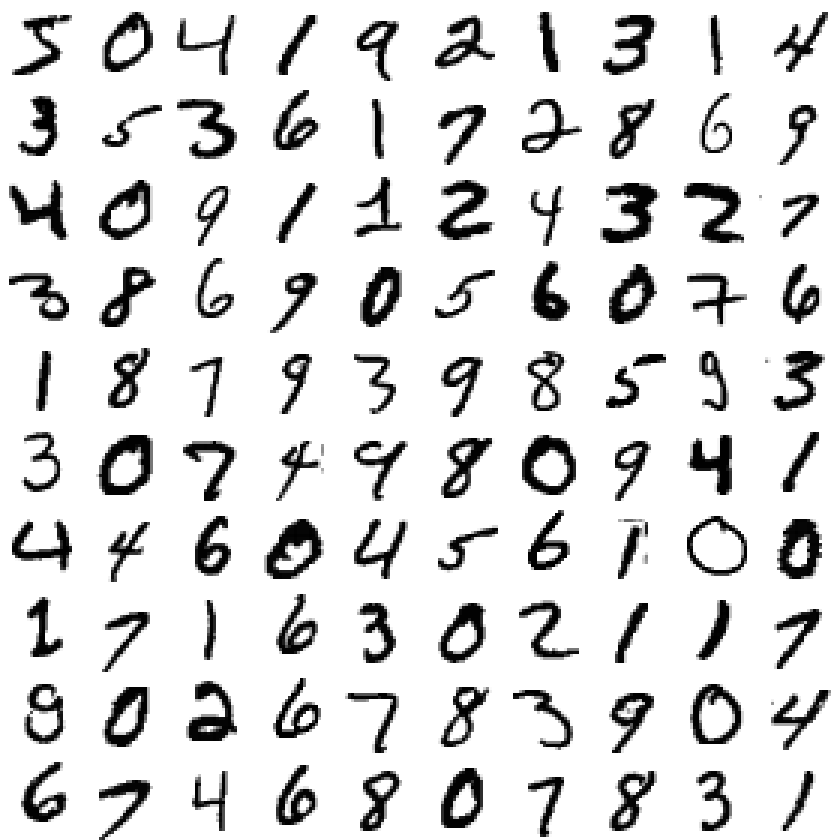

In [124]:
mnist_data = getOMLDataSet(did = 554)$data # MNIST dataset from OpenML
par( mfrow = c(10,10), mai = c(0,0,0,0)) # 10x10 grid
for(i in 1:100){ # Convert first 100 rows to 28x28 matrix and plot 
    y = matrix(as.matrix(mnist_data[i, 1:784]), nrow=28)
    image( y[,nrow(y):1], axes = FALSE, col = gray(255:0 / 255))}

## How neurons work
- Structure: dendrites, cell body, axon, synapses
![alt text](http://cinpla.org/wp-content/uploads/2015/02/neuron-1024x695.jpg)

- Neuron triggers, sends action potential (voltage) through axon
- Transmission across synapse is chemical
    - Action potential causes release of neurotransmitters
    - Diffuse over to other side, create signal in next dendrite
    - Synapse connection can be weak or strong
- **Hebbian learning**: neurons that fire together, wire together
    - Synapses grow stronger through experience
    - Long-term potentiation: more dendritic receptors

## Perceptron: Representation

In [55]:
perceptron = function() {
grid.lines(c(0.6, 0.9), rep(0.5, 2), arrow = arrow(type = "closed", length = unit(0.1, "inches")))
for (j in 1:4) {
  i <- 0.5 + c(0, 2:4)[j]
  l <- sqrt(0.5^2 + (0.5 - i/5)^2) / 0.1
  grid.lines(c(0.1, 0.6 - 0.5/l), c(i/5, 0.5 - (0.5 - i/5)/l), arrow = arrow(type = "closed", length = unit(0.1, "inches")))
  grid.circle(0.1, i/5, r = 0.05, gp = gpar(fill = "white"))
  n <- c("p", 3:1)[j]
  grid.text(substitute(x[n], list(n = n)), 0.1, i/5)
  grid.text(substitute(w[n], list(n = n)), 0.3, unit(0.5 - (0.5 - i/5) / 0.5 * 0.3, "npc") + unit(1, "lines"))
}
grid.circle(0.6, 0.5, r = 0.1, gp = gpar(fill = "white"))
grid.text(expression(sigma), 0.6, 0.5)
grid.points(unit(rep(0.1, 3), "npc"),
            unit(seq(1.2, 1.8, length.out = 3)/5, "npc"), size = unit(0.5, "char"),
            pch = 1, gp = gpar(fill = 1))
grid.text("y", 0.95, 0.5)
}

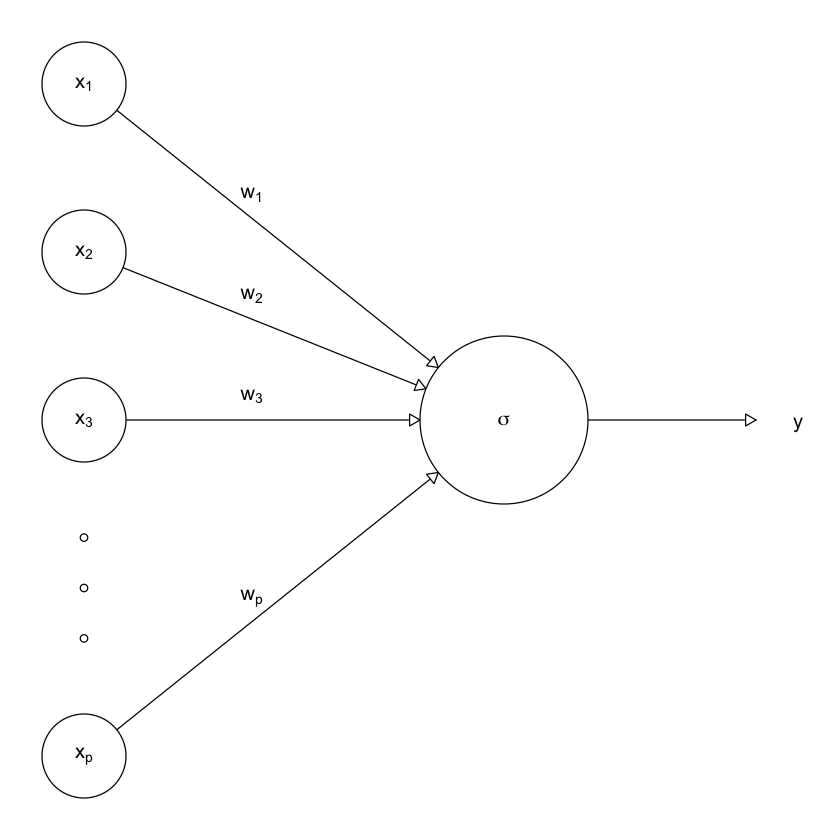

In [56]:
perceptron()

- $p$ binary inputs $x_1..x_p$
- One binary output $y = f(x)$
- Single neuron, every connection has weight $w_1..w_p \in I\!R$
- Neuron receives weighted sum of inputs
- Threshold function $\sigma$ defines when neuron fires 
$$f(x) = \sigma(\sum_{i=1}^p w_i x_i) = \sigma(w \cdotp x) = \begin{cases}
1, & w \cdotp x \geq \theta \\
0, & \text{otherwise}
\end{cases}
$$
- Mathematical simplification: add bias $w_0 = -\theta$, $x_0=1$
$$f(x) = \sigma(\sum_{i=0}^p w_i x_i) = \sigma(w \cdotp x) = \begin{cases}
1, & w \cdotp x \geq 0 \\
0, & \text{otherwise}
\end{cases}
$$

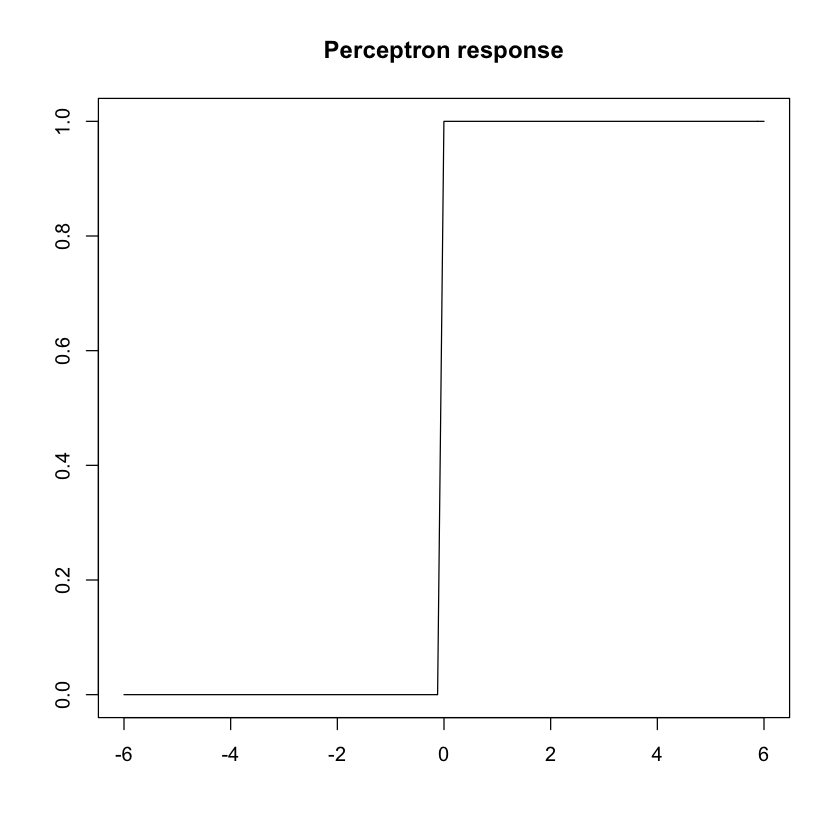

In [118]:
px <- seq(-6, 6, length.out = 101)
plot(px, px>=0, type = "l", xlab = "", ylab = "", main = "Perceptron response")

## What can perceptrons learn?
- Can it learn logical gates (AND, OR, XOR)?
- Shall we try MNIST?
    - 784 inputs, lots of weights to learn.

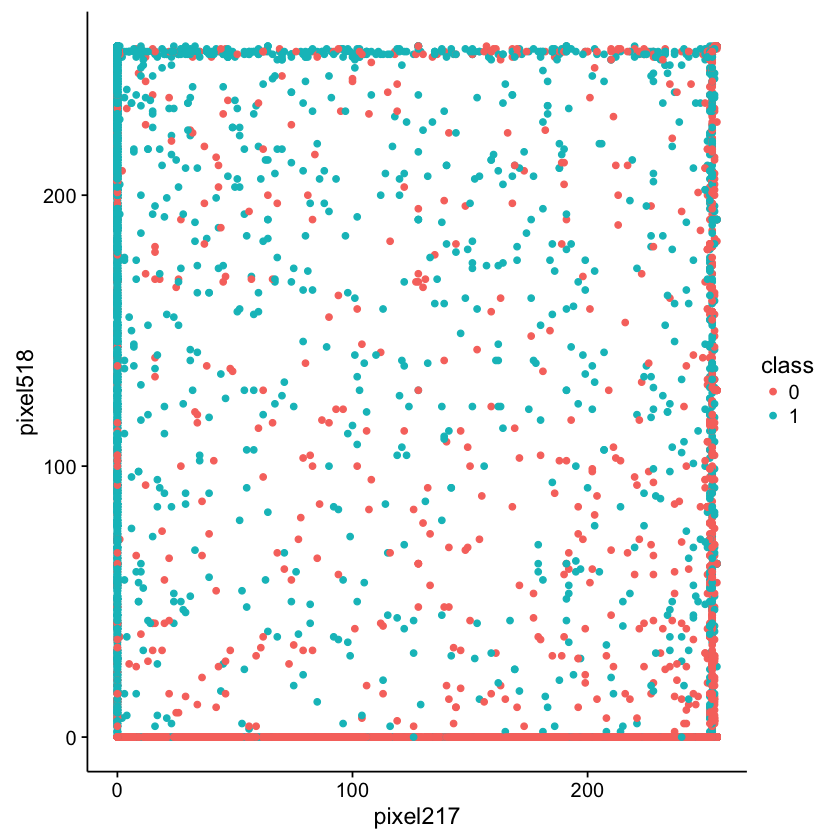

In [205]:
mnist_bin = droplevels(subset(mnist_data, class %in% c(0,1))) #MNIST with only 0 and 1 (binary)
# Now, plot output for 2 random pixels
ggplot(data=mnist_bin, aes(x=pixel217, y=pixel518, color=class)) + geom_point()

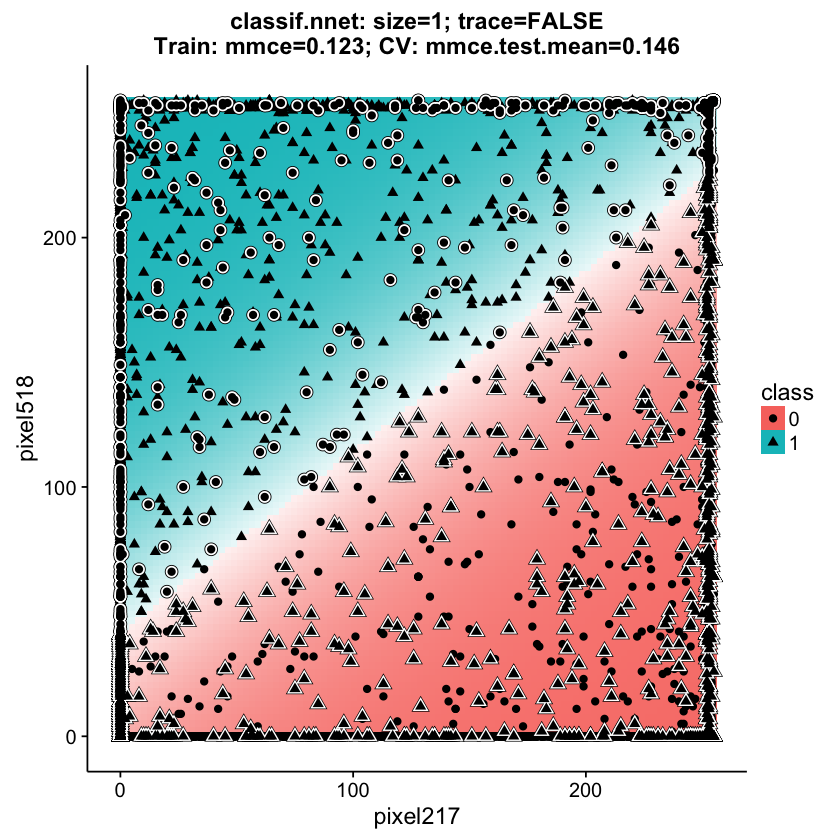

In [157]:
mnist_task = makeClassifTask(data = mnist_bin, target = "class")
# We're mimicking a perceptron by constructing a neural net with 1 hidden node
# Actually this is a sigmoid perceptron, but still quite close
perceptron = makeLearner("classif.nnet", par.vals = list(size = 1, trace = FALSE))
plotLearnerPrediction(perceptron, mnist_task, features = c("pixel217", "pixel518")) + theme_cowplot()

### Perceptrons can only learn linear functions
- Indeed: 
$$f(x) = \sigma(\sum_{i=0}^p w_i x_i) = w_0 x_0 + w_1 x_1 + .. + w_p x_p $$
- In $n$ dimensions, perceptron can only learn hyperplanes
- Simple concepts like XOR cannot be learned
    - Requires a 2-layer perceptron
- Hence, we need more than 1 neuron, we want networks of these

## Perceptron: Optimization (training)
- Perceptron $\sim$ device that makes decisions by weighing up evidence
- You have to learn how much each input affects the desired outcome
- Like a social network: should I go see movie X?
    - Each friend possibly influences your decision
    - You learn whose recommendations to trust more than others
- How to learn those weights?

### Perceptron training rule
- Initialize weights randomly
- With every example $i$, update weights:
$$w_i \leftarrow w_i + \Delta w_i$$
where
$$\Delta w_i = \eta(t-o)x_i$$
with:
- t = c(x): target value
- o: perceptron output
- $\eta$: small constant (e.g. 0.1) called *learning rate*
- Why does this work?

- If outputting correct value: do nothing
- If outputting incorrect value:
    - Predict 0 when target is 1: $t-o=1$
        - Increase weight of inputs that are hot
    - Predict 1 when target is 0: $t-o=-1$
        - Decrease weight of inputs that are hot

- Any guarantee that it will converge?
- Proof that it will converge if:
    - $\eta$ is sufficiently small
    - Training data is linearly separable
        - with noise, no convergence
        - $\Delta w_i$ will move hyperplane towards noise, misclassify other points
        - 'solution': stop after $t$ iterations


## Gradient descent
- Still learn hyperplane, but differently
    - Most robust, and generalizes to complex networks
- First, consider *linear unit*:
$$o = w_0 + w_1 x_1 + .. + w_p x_p $$
- Let's learn weights that minimize the squared error:
$$E[w] = \frac{1}{2} \sum\limits_{d=1}^{n}  (t_d-o_d)^2 $$
with $n$ training examples
- Quadratic function of linear function of weight = quadratic functions of weights
    - Much easier to learn (no local mimima)
    - True for perceptron (not general network)



### How do you find optimum?

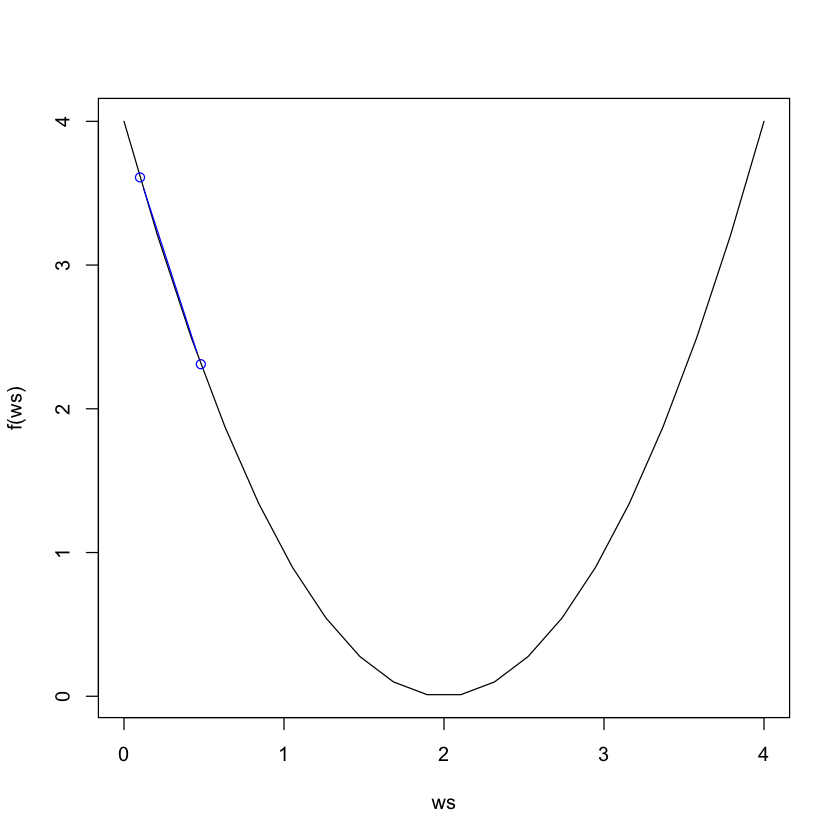

In [185]:
ws = seq(0,4,len=20) # for plotting
f = function(w) { (w-2)^2 } # function to optimize
plot(ws , f(ws), type="l") # Plot target
w = c(0.1,0.1-0.1*2*(0.1-2)) # We'll see later how to compute this
lines (w, f(w), type="b",col="blue")

- Gradient:
$$\nabla E[w] = \left[ \frac{\delta E}{\delta w_0} , \frac{\delta E}{\delta w_1} , \ldots, \frac{\delta E}{\delta w_p} \right]$$
- Vector where each component is partial derivative of error with respect to that weight
    - Large value: move in that direction a lot
- Training rule:
$$ \Delta w = - \eta E[w] $$ 
i.e. 
$$ \Delta w_i = - \eta \frac{\delta E}{\delta w_i} $$ 

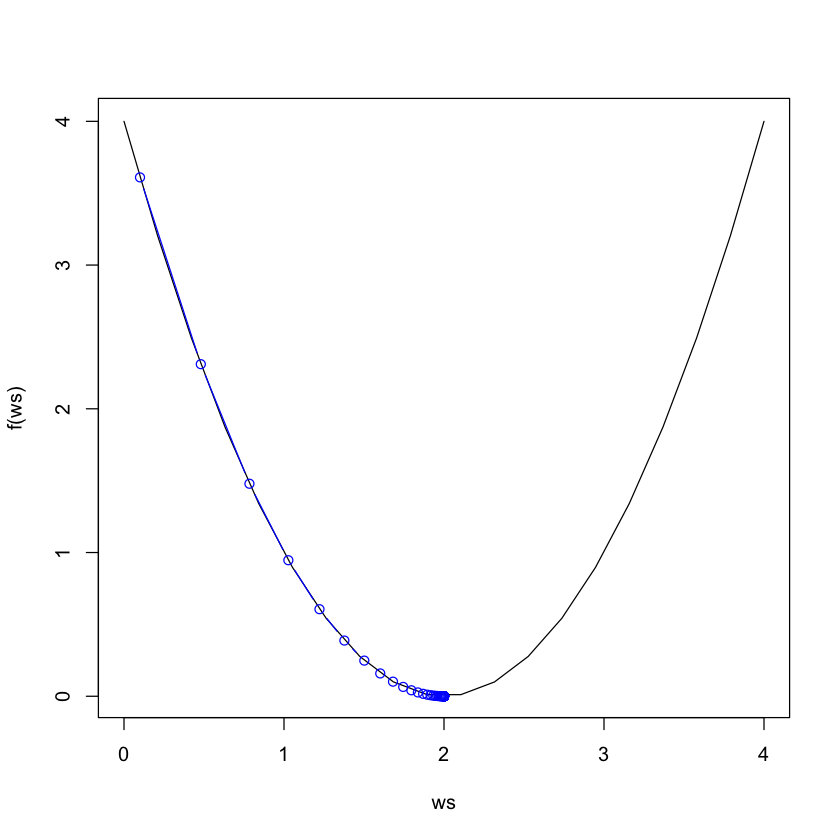

In [204]:
grad = function(w){2*(w-2)} # gradient df/dw 
 
w = 0.1 # initialize (first guess)
learningRate = 0.1 # try smaller and larger values
wtrace = w # initialize (first guess)
ftrace = f(w) # store y-values
for (step in 1:100) {
w = w - learningRate*grad(w) # gradient descent update
wtrace = c(wtrace,w) # store next x-value
ftrace = c(ftrace,f(w)) # store next y-value
}

plot(ws , f(ws), type="l") # Plot target
lines( wtrace , ftrace , type="b",col="blue") # Plot steps

### Computing the gradient
$$
\begin{align} 
\frac{\delta E}{\delta w_i} = \frac{\delta}{\delta w_i} \frac{1}{2} \sum_d (t_d-o_d)^2 \\ & 
 = \frac{1}{2} \sum_d \frac{\delta}{\delta w_i} (t_d-o_d)^2 \\ &
 = \frac{1}{2} \sum_d 2 (t_d-o_d) \frac{\delta}{\delta w_i} (t_d-o_d) \\ &
 = \sum_d (t_d-o_d) \frac{\delta}{\delta w_i} (t_d-w \cdotp x_d)\\ & 
 = \sum_d (t_d-o_d) (-x_{i,d})
\end{align}
$$

### Gradient descent
- Initialize each $w_i$ to some small random value
- Until termination condition is met:
    - Initialize each $\Delta w_i$ to 0
    - For each (x,t) in training examples, do:
        $$\Delta w_i \leftarrow \Delta w_i + \eta(t-o)x_i$$
    - For each linear unit weight w_i, do:
        $$w_i \leftarrow w_i + \Delta w_i $$

# weights:  5
initial  value 10224.006537 
iter  10 value 5232.791152
iter  20 value 5212.206316
iter  30 value 5124.183676
iter  40 value 5113.415955
iter  50 value 5109.301886
iter  60 value 5021.879675
final  value 5021.799567 
converged
# weights:  5
initial  value 11500.276477 
iter  10 value 4851.417742
iter  20 value 4774.501144
iter  20 value 4774.501122
iter  20 value 4774.501122
final  value 4774.501122 
converged
# weights:  5
initial  value 9746.191685 
iter  10 value 4534.410567
iter  20 value 4428.864166
iter  30 value 4279.029180
iter  40 value 4275.725179
final  value 4275.724186 
converged
# weights:  5
initial  value 9738.423876 
iter  10 value 7237.066693
iter  20 value 4681.590380
iter  30 value 4573.803819
iter  40 value 4568.382011
final  value 4568.295740 
converged
# weights:  5
initial  value 9380.506381 
iter  10 value 4603.716474
iter  20 value 4594.770100
final  value 4594.593781 
converged
# weights:  5
initial  value 9491.839586 
iter  10 value 6216.765091

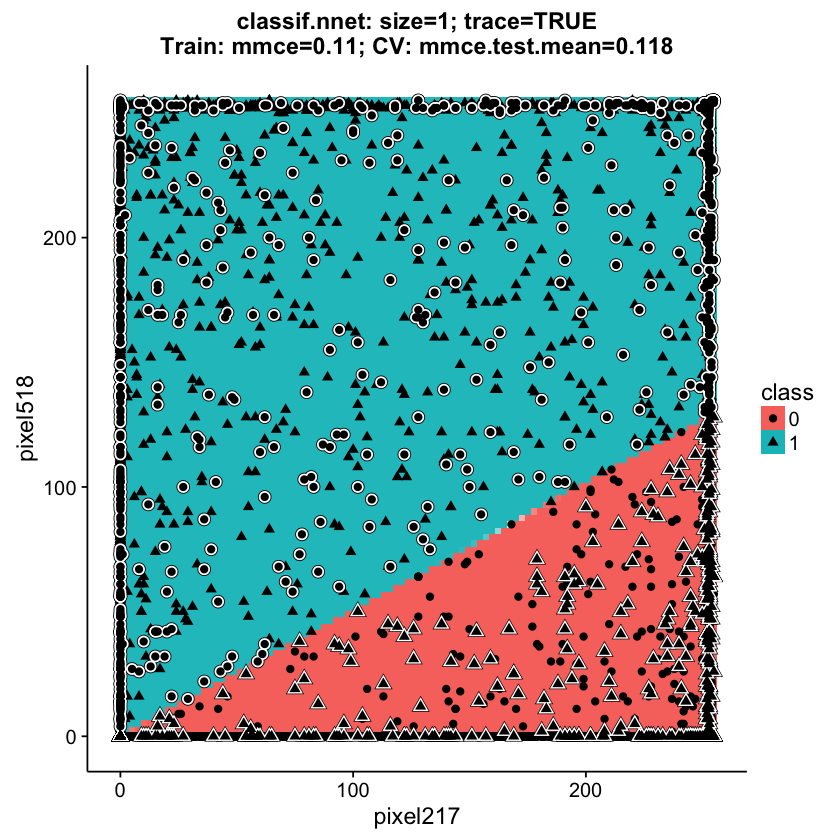

In [192]:
# Print the gradient descent trace
perceptron = makeLearner("classif.nnet", par.vals = list(size = 1, trace = TRUE))
plotLearnerPrediction(perceptron, mnist_task, features = c("pixel217", "pixel518")) + theme_cowplot()

### Gradient descent: conclusions
- Guaranteed to converge to hypothesis with minumum squared error
- Given sufficiently small learning rate $\eta$
- Even when training data contains noise
- Even when training data is not separable by H
- In general, there is no closed form solution for $\frac{\delta E}{\delta w_i} = 0$, so we need gradient descent

### Stochastic gradient descent
- Batch mode: look at all examples, compute gradient, update by that gradient
- Stochastic gradient descent (incremental mode):
    - Update after each training example
- Faster: you do more updates
- Noise may be helpful: avoids local optima (bouncing ball)
- No guarantees, but works well in practice

## Refining the model of the neuron
- Action potentials are short-lived *spikes*
- Neuron spikes more frequently the more it is stimulated
    - spike frequency $\nu$
    - saturates at max. frequency
- The amount of stimulation is called membrane potential $u$
- Spike frequency is non-linear function of membrane potential
    - Sigmoid function, or S-curve
    - Most important curve in the world: phase transitions
$$\nu = \sigma(u) = \frac{1}{1+e^{-u}}$$

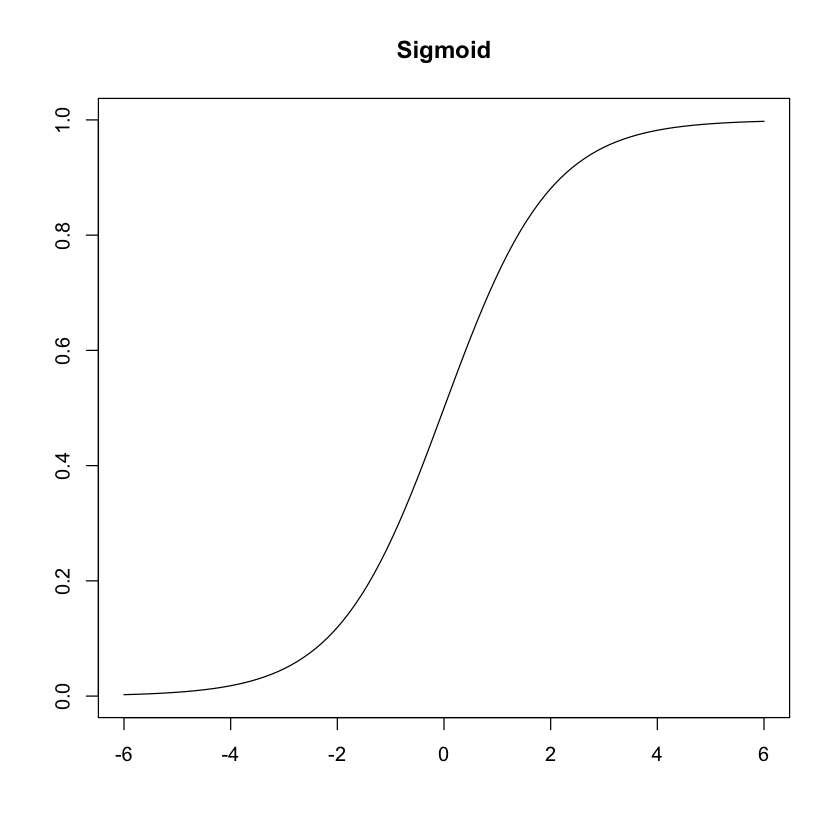

In [120]:
plot(px, sigmoid(px, a = 1), type = "l", 
        xlab = "", ylab = "", main = "Sigmoid")

## Neural net
- Representation
    - Many neuron-like units
    - Many weighted interconnections
    - Highly parallel processes
- Optimization
    - Learning: tune weights automatically

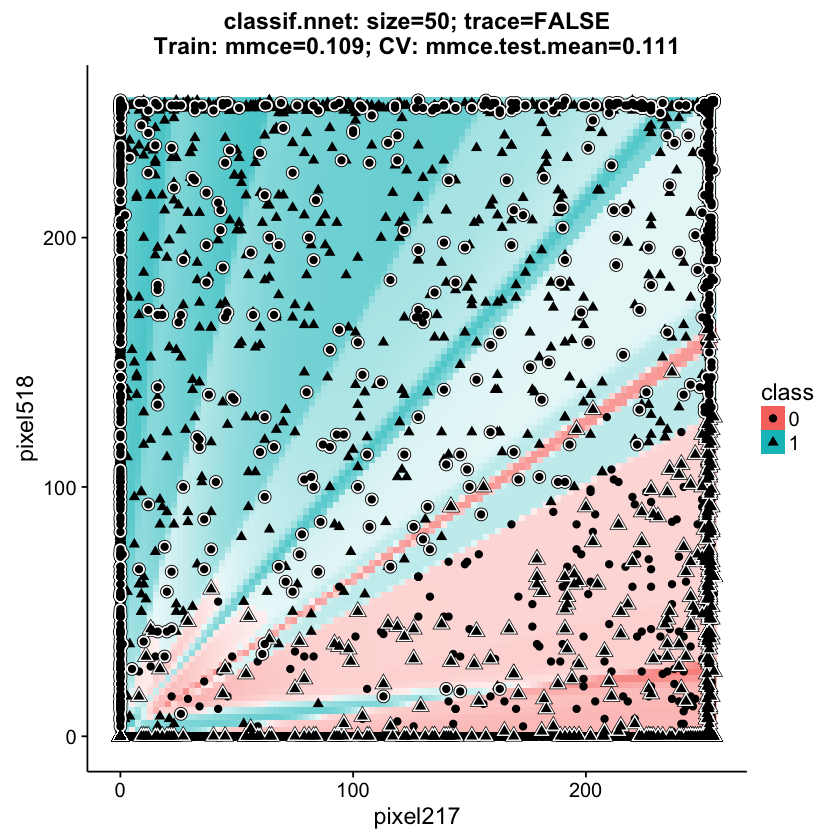

In [191]:
mlp = makeLearner("classif.nnet", par.vals = list(size = 50, trace = FALSE))
plotLearnerPrediction(mlp, mnist_task, features = c("pixel217", "pixel518")) + theme_cowplot()

## Questions?

## Acknowledgements
Thanks to Bernd Bischl and Tobias Glasmachers for useful input.